# Classification d'image vue de face de veaux avec Unet

## Import des dependances

In [1]:
from sklearn.model_selection import train_test_split
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
from torch.utils.data import Dataset
from transformers import Trainer, TrainingArguments
import torch
import torch.nn as nn
import torchvision.models.segmentation as segmentation
from torchvision import models
from torchvision.transforms import v2
from torchvision.io import read_image
import numpy as np
import cv2
import os
import sys
import torch.optim as optim
from torch.utils.data import DataLoader
from sklearn.metrics import accuracy_score, recall_score, f1_score, classification_report
from tqdm import tqdm
import random
from PIL import Image as PilImage
from omnixai.data.image import Image
from omnixai.explainers.vision import LimeImage, VisionExplainer
from omnixai.preprocessing.image import Resize
from efficientnet_pytorch import EfficientNet

# Local dep
project_dir = '/data/konrad/'
sys.path.insert(0, project_dir)

from helpers.helpers import get_indices, load_face_data, load_local_model
from helpers.datasets import CalfFaceDataset
from helpers.interp import GradCam, generate_cam, display_predicted_cam
from helpers.trainers import train_model, validate_model, plot_metrics

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

2024-06-14 15:19:50.662239: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-06-14 15:19:51.302771: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


## Import de la data

Le fichier [face_eda](datasets/face_eda.ipynb) presente une etude de la donnee en generale. 

In [2]:
DATA_FILE = '/data/konrad/datasets/CompleteDatasetNormalFace/Face_annotations.csv'
IMAGE_DIR = "/data/konrad/datasets/CompleteDatasetNormalFace"

df, labels, label2id, id2label = load_face_data(DATA_FILE, IMAGE_DIR)

## Classes et utilitaires

In [6]:
backbone = EfficientNet.from_pretrained('efficientnet-b0', num_classes = 3)
# backbone

Loaded pretrained weights for efficientnet-b0


In [9]:
class Classifier(nn.Module):
    def __init__(self, num_classes, name, from_pretrained=True):
        super(Classifier, self).__init__()
        self.name = name
        
        # Load the EfficientNet backbone
        if from_pretrained:
            self.backbone = EfficientNet.from_pretrained('efficientnet-b0')  # You can choose other variants like 'efficientnet-b1', 'efficientnet-b2', etc.
        else:
            self.backbone = EfficientNet.from_name('efficientnet-b0')

        self.conv_head = self.backbone._conv_head  # 1280 is the number of output channels for EfficientNet-B0
        self.classifier_head = self.backbone._fc

       # Replace the original classifier head with a new one
        self.backbone._fc = nn.Linear(self.backbone._fc.in_features, num_classes)

    def forward(self, x):
        output = self.backbone(x)
        return output

## Entrainement du modele

### Dataset setup

In [7]:
train_indices, test_indices, valid_indices = get_indices(len(df))
IMAGE_SIZE = 256

train_transform = v2.Compose([
    v2.Resize(size=(IMAGE_SIZE, IMAGE_SIZE)),
    v2.AutoAugment(v2.AutoAugmentPolicy.IMAGENET),
    v2.ToDtype(torch.float32, scale=True),
    v2.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])
train_dataset = CalfFaceDataset(df.iloc[train_indices, :].reset_index(drop=True), IMAGE_DIR, transform=train_transform)

test_transform = v2.Compose([
    v2.Resize(size=(IMAGE_SIZE, IMAGE_SIZE)),
    v2.ToDtype(torch.float32, scale=True),
    v2.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])
test_dataset = CalfFaceDataset(df.iloc[test_indices, :].reset_index(drop=True), IMAGE_DIR, transform=test_transform)
valid_dataset = CalfFaceDataset(df.iloc[valid_indices, :].reset_index(drop=True), IMAGE_DIR, transform=test_transform)

# Data loaders
batch_size = 8
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
valid_loader = DataLoader(valid_dataset, batch_size=batch_size * 2, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size * 2, shuffle=False)

# dl = valid_loader.dataset.data_frame
# class_counts = dl['label'].value_counts()

# # Plot the distribution
# plt.figure(figsize=(8, 6))
# class_counts.plot(kind='bar')
# plt.title('Distribution of Classes in Validation set')
# plt.xlabel('Class')
# plt.ylabel('Count')
# plt.xticks(rotation=45)
# plt.grid(axis='y', linestyle='--', alpha=0.7)
# plt.show()

### Entrainement et validation

In [11]:
model_name = "efficientnetb0"
model = Classifier(num_classes=len(labels), name=model_name, from_pretrained=True)  # Adjust num_classes according to your dataset
model.to(device)

# Loss and optimizer
lr = 1e-4
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=2, verbose=True)

epochs = 10
patience = 3

train_losses, train_accuracies, train_recalls, train_f1_scores, valid_losses, valid_accuracies, valid_recalls, valid_f1_scores = train_model(model, train_loader, test_loader, scheduler, patience, optimizer, num_epochs = epochs)

Loaded pretrained weights for efficientnet-b0


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:04<00:00,  3.85it/s]


Epoch [1/10]
Train Loss: 1.0790, Accuracy: 0.3758, Recall: 0.3758, F1 Score: 0.3559
Valid Loss: 1.1016, Accuracy: 0.3684, Recall: 0.3684, F1 Score: 0.2632
------------------------------


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:04<00:00,  3.81it/s]


Epoch [2/10]
Train Loss: 0.9126, Accuracy: 0.6242, Recall: 0.6242, F1 Score: 0.6036
Valid Loss: 1.1360, Accuracy: 0.4211, Recall: 0.4211, F1 Score: 0.3410
------------------------------


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:04<00:00,  3.82it/s]


Epoch [3/10]
Train Loss: 0.8186, Accuracy: 0.7114, Recall: 0.7114, F1 Score: 0.7053
Valid Loss: 1.2534, Accuracy: 0.3684, Recall: 0.3684, F1 Score: 0.2583
------------------------------


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:04<00:00,  3.83it/s]


Epoch [4/10]
Train Loss: 0.7588, Accuracy: 0.7047, Recall: 0.7047, F1 Score: 0.6993
Valid Loss: 1.3650, Accuracy: 0.3684, Recall: 0.3684, F1 Score: 0.2515
------------------------------
Early stopping triggered


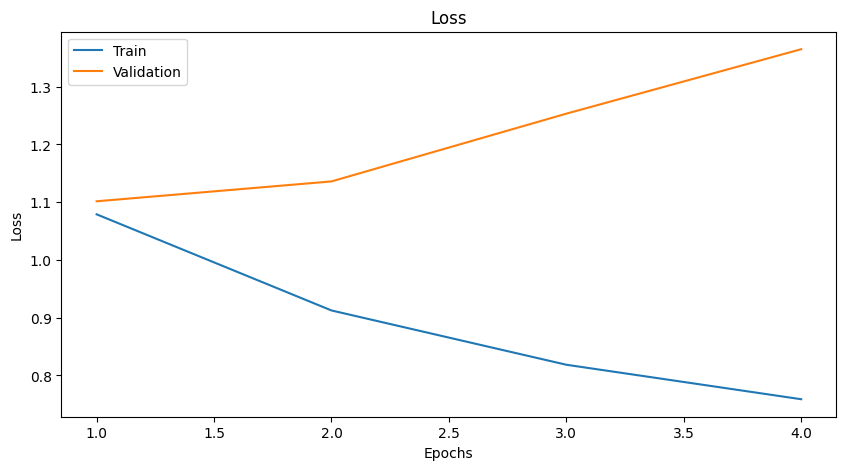

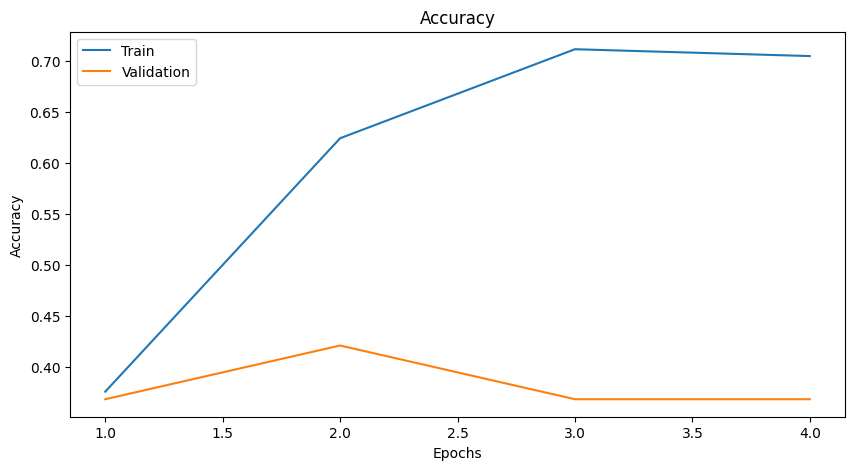

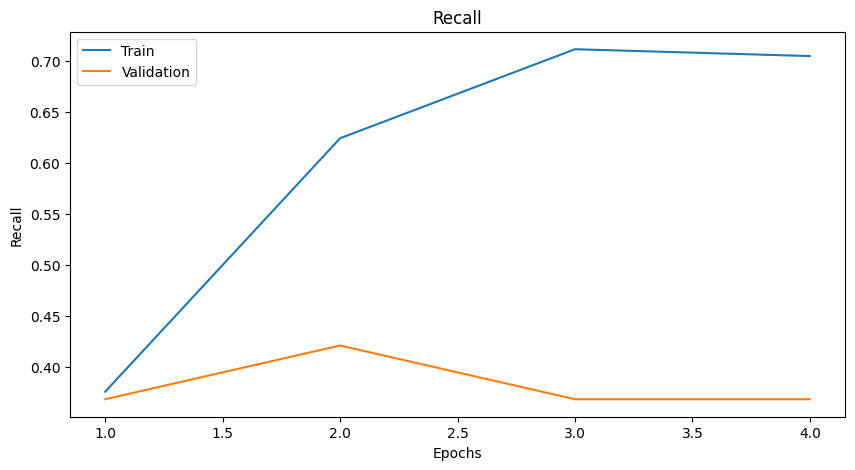

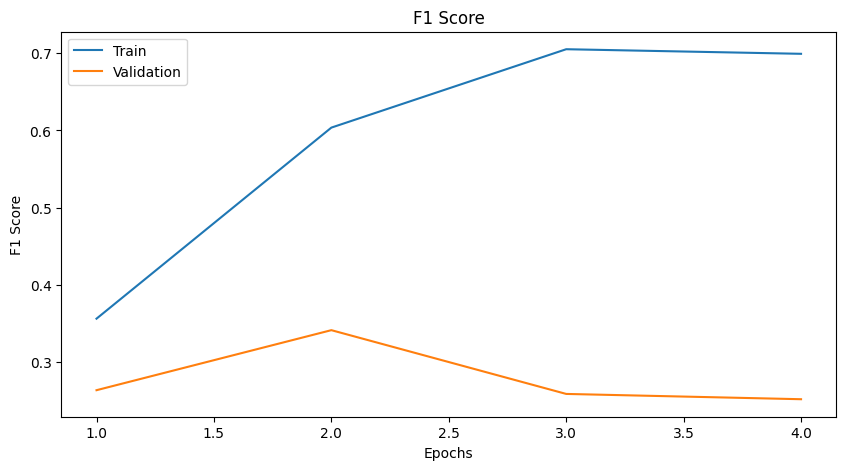

In [12]:
plot_metrics(train_losses, train_accuracies, train_recalls, train_f1_scores,  valid_losses, valid_accuracies, valid_recalls, valid_f1_scores)

In [13]:
validate_model(model, valid_loader, label2id.keys())

Test Accuracy: 0.3158, Micro Recall: 0.3158, Micro F1 Score: 0.3158
Class: Diarrhea, Precision: 0.3846, Recall: 0.6250, F1 Score: 0.4762
Class: Pneumonia, Precision: 0.0000, Recall: 0.0000, F1 Score: 0.0000
Class: Healthy, Precision: 0.1667, Recall: 0.2500, F1 Score: 0.2000


/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


## Interpretation with Lime

In [14]:
test_images = [Resize((256, 256)).transform(Image(PilImage.open(IMAGE_DIR + '/' + p["path"]).convert('RGB'))).to_numpy() for p in valid_loader.dataset.data_frame[:5].to_dict('records')]
img = Image( data=np.concatenate(test_images), batched=True)
print(img.shape)

(5, 256, 256, 3)


In [15]:
# model_name = "deeplab"
# model = Classifier(num_classes=len(labels), name=model_name, from_pretrained=False)  # Adjust num_classes according to your dataset
# load_local_model(model)
# model = model.to(device)

In [16]:
# The preprocessing function
transform = v2.Compose([
    v2.Resize(256),
    v2.CenterCrop(224),
    v2.ToImage(),
    v2.ToDtype(torch.float32, scale=True),
    v2.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])
preprocess = lambda ims: torch.stack([transform(im.to_pil()) for im in ims]).to(device)
postprocess = lambda logits: torch.nn.functional.softmax(logits, dim=1)

In [17]:
# explainer = VisionExplainer(
#     explainers=["gradcam", "lime"],
#     mode="classification",
#     model=model,
#     preprocess=preprocess,
#     postprocess=postprocess,
#     params={
#         "gradcam": {"target_layer": model.conv_head},
#         # "scorecam": {"target_layer": model.conv_head},
#     }
# )
# # Generate explanations
# local_explanations = explainer.explain(img)

explainer = VisionExplainer(
    explainers=["gradcam", "lime", "ig", "ce", "scorecam",
                "smoothgrad", "guidedbp", "layercam"],
    mode="classification",
    model=model,
    preprocess=preprocess,
    postprocess=postprocess,
    params={
        "gradcam": {"target_layer": model.conv_head},
        "ce": {"binary_search_steps": 2, "num_iterations": 100},
        "scorecam": {"target_layer": model.conv_head},
        "layercam": {"target_layer": model.conv_head},
    }
)
# Generate explanations
local_explanations = explainer.explain(img)

/data/konrad/jupiter_env/lib/python3.10/site-packages/torch/nn/modules/module.py:1373: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

/data/konrad/jupiter_env/lib/python3.10/site-packages/torch/nn/modules/module.py:1373: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "


  0%|          | 0/1000 [00:00<?, ?it/s]

/data/konrad/jupiter_env/lib/python3.10/site-packages/torch/nn/modules/module.py:1373: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "


  0%|          | 0/1000 [00:00<?, ?it/s]

/data/konrad/jupiter_env/lib/python3.10/site-packages/torch/nn/modules/module.py:1373: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "


  0%|          | 0/1000 [00:00<?, ?it/s]

/data/konrad/jupiter_env/lib/python3.10/site-packages/torch/nn/modules/module.py:1373: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "
/data/konrad/jupiter_env/lib/python3.10/site-packages/torch/nn/modules/module.py:1373: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "


Binary step: 2 |███████████████████████████████████████-| 99.0% 

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1280/1280 [00:10<00:00, 118.77it/s]


{'image': '0-6485778962342293__6787_ch2_from_02032022210830__to__02032022211733-mp4-t-274-733333_jpg', 'xmin': 1086.9014736017357, 'ymin': 617.67018150997, 'xmax': 1719.6682738669238, 'ymax': 1246.330188679245, 'label': 'Diarrhea', 'target': 0, 'path': '0.6485778962342293__6787_ch2_from_02032022210830__to__02032022211733.mp4#t=274.733333.jpg'}


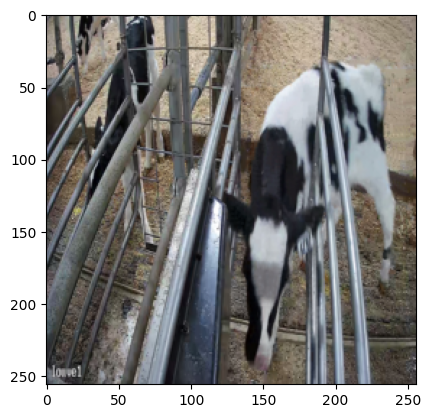

In [18]:
index=0
print(valid_loader.dataset.data_frame[:10].to_dict('records')[index])
plt.imshow(test_images[index][0])

# for name, explanations in local_explanations.items():
#     print(f"{name}:")
#     explanations.ipython_plot(index, class_names=labels)

predict:


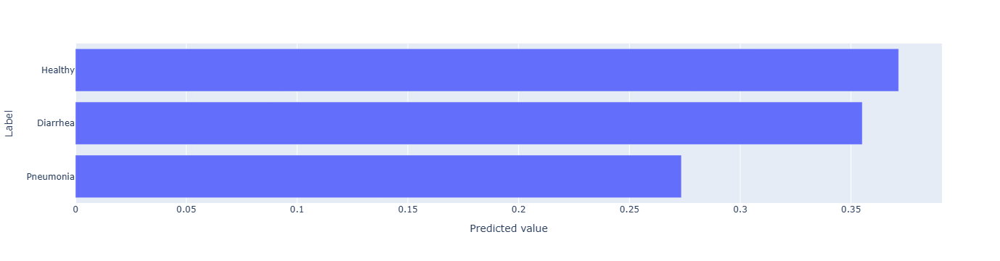

gradcam:


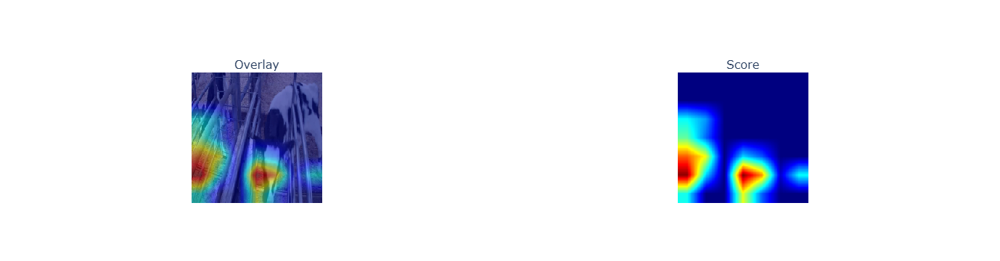

lime:


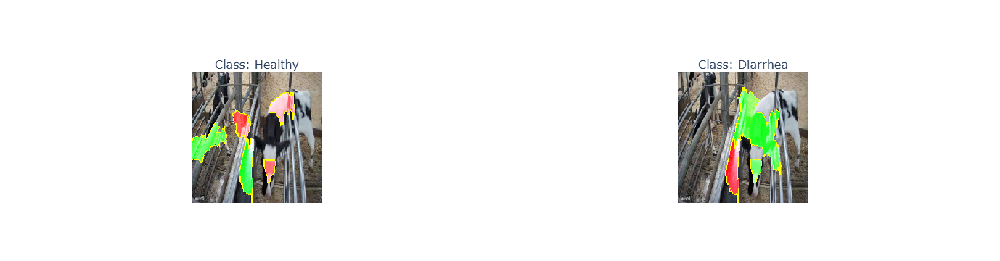

ig:


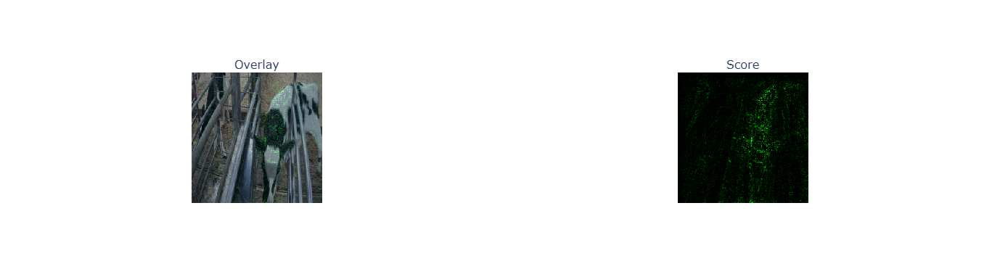

ce:


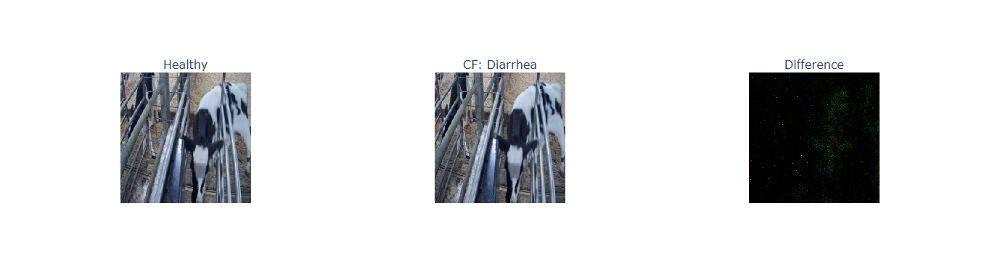

scorecam:


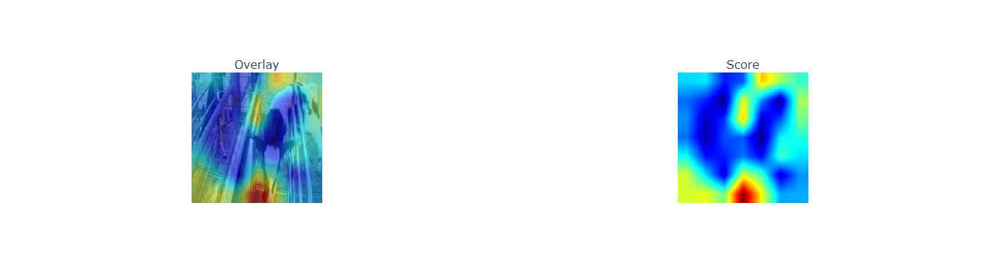

smoothgrad:


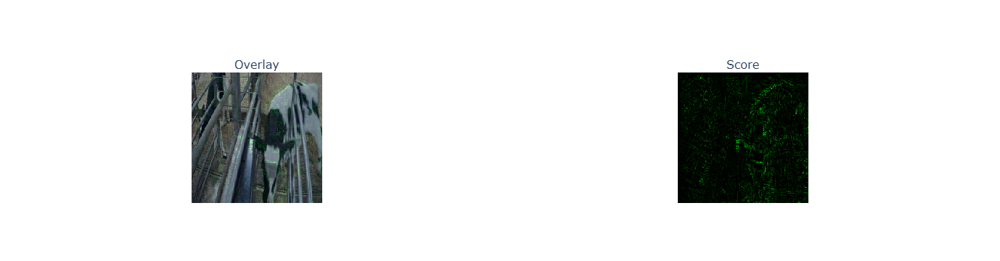

guidedbp:


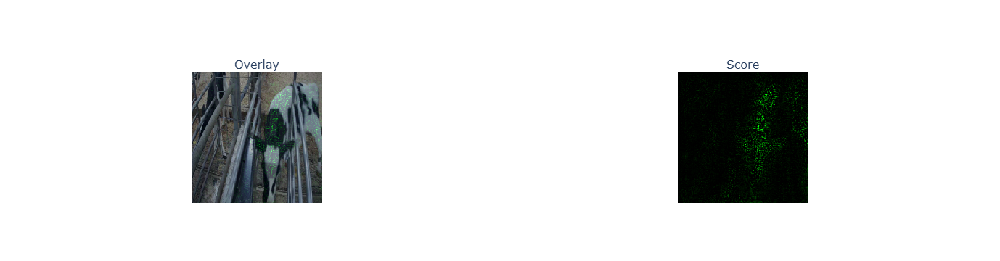

layercam:


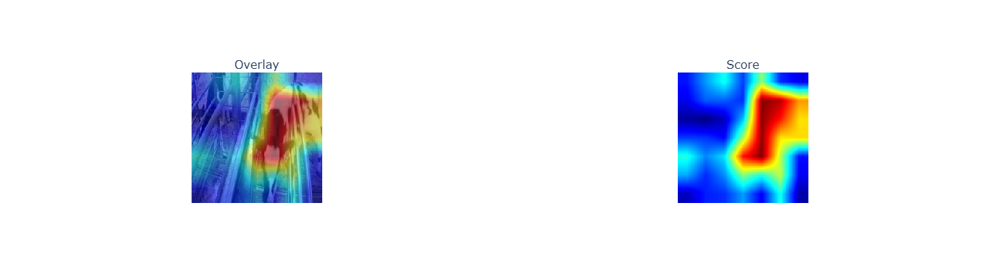

In [19]:
# index=0
# print(valid_loader.dataset.data_frame[:10].to_dict('records')[index])
# plt.imshow(test_images[index][0])

for name, explanations in local_explanations.items():
    print(f"{name}:")
    explanations.ipython_plot(index, class_names=labels)

{'image': '0-1103025738752118__6768_ch2_from_28022022203330__to__28022022204201-mp4-t-378-8_jpg', 'xmin': 1189.4344022001935, 'ymin': 423.5659657901096, 'xmax': 1645.778031310445, 'ymax': 1094.2794629913014, 'label': 'Pneumonia', 'target': 1, 'path': '0.1103025738752118__6768_ch2_from_28022022203330__to__28022022204201.mp4#t=378.8.jpg'}


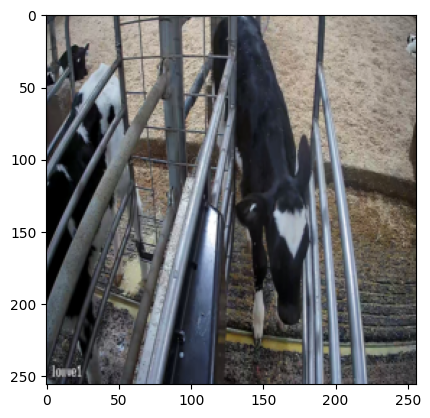

In [20]:
index=4
print(valid_loader.dataset.data_frame[:10].to_dict('records')[index])
plt.imshow(test_images[index][0])

# for name, explanations in local_explanations.items():
#     print(f"{name}:")
#     explanations.ipython_plot(index, class_names=labels)

predict:


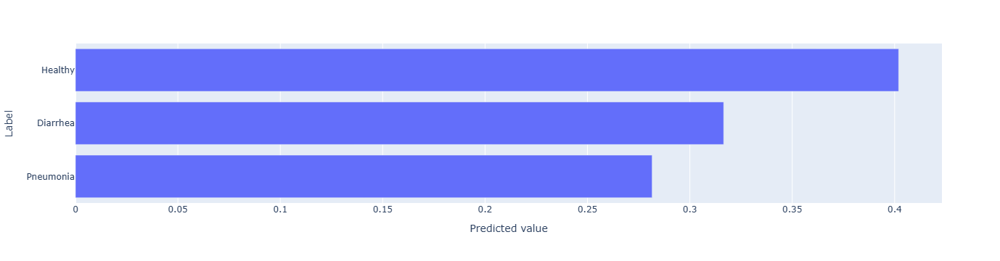

gradcam:


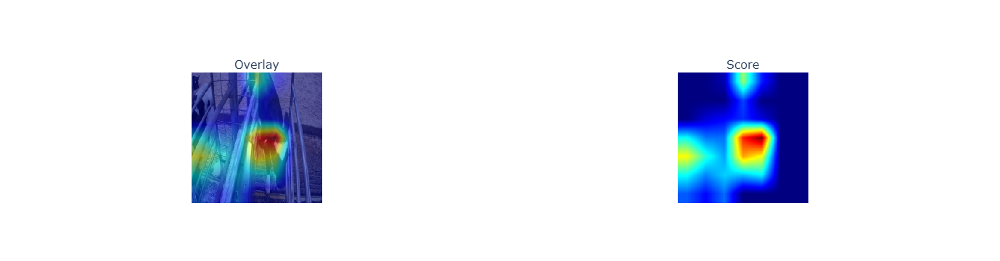

lime:


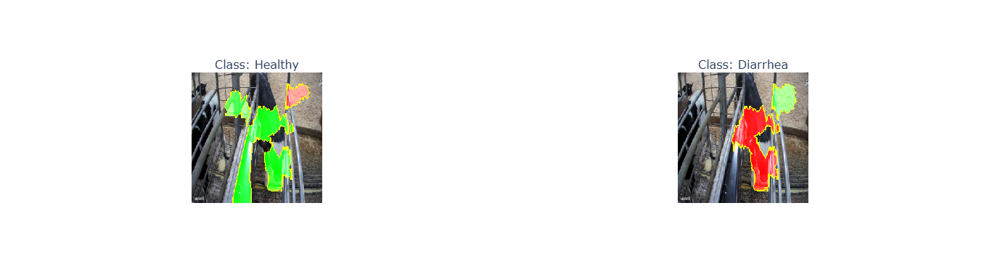

ig:


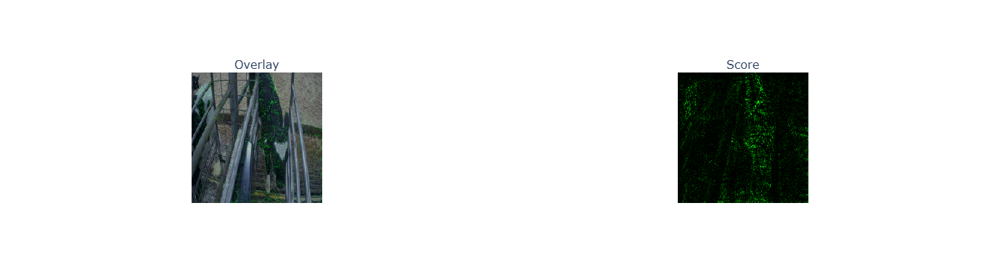

ce:


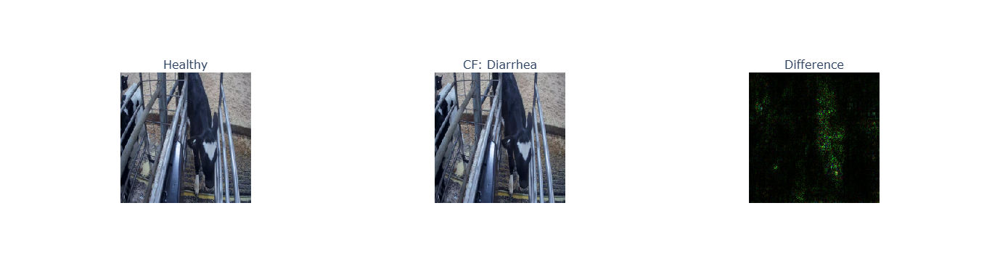

scorecam:


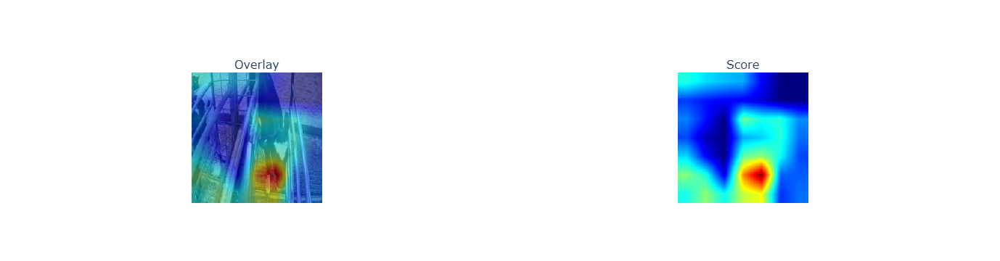

smoothgrad:


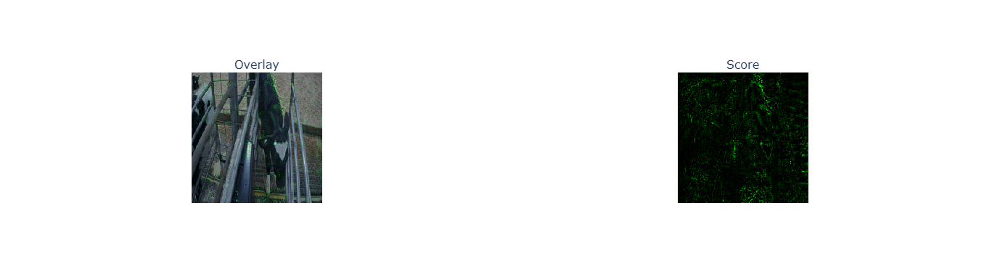

guidedbp:


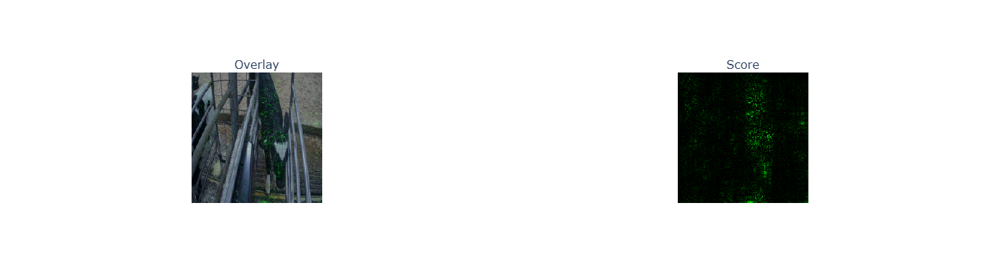

layercam:


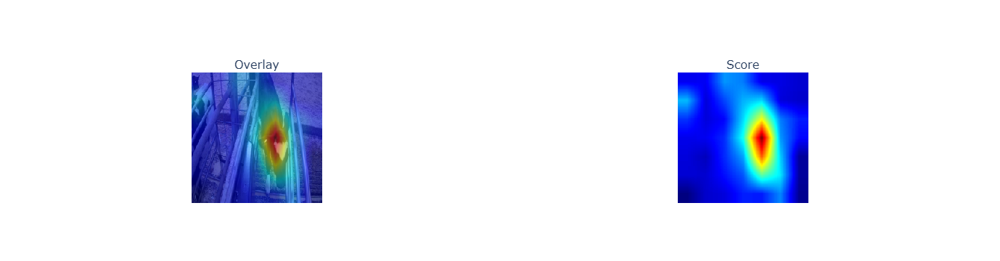

In [21]:
# index=0
# print(valid_loader.dataset.data_frame[:10].to_dict('records')[index])
# plt.imshow(test_images[index][0])

for name, explanations in local_explanations.items():
    print(f"{name}:")
    explanations.ipython_plot(index, class_names=labels)

{'image': '0-760606633429213__6773_ch2_from_28022022122730__to__28022022123544-mp4-t-63-8_jpg', 'xmin': 1868.084197203472, 'ymin': 269.9954094862243, 'xmax': 2121.3686716489874, 'ymax': 655.9054752827509, 'label': 'Healthy', 'target': 2, 'path': '0.760606633429213__6773_ch2_from_28022022122730__to__28022022123544.mp4#t=63.8.jpg'}


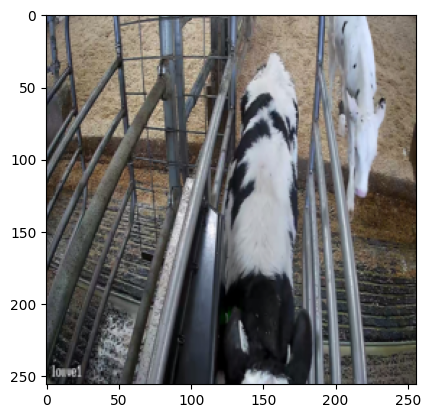

In [22]:
index=3
print(valid_loader.dataset.data_frame[:10].to_dict('records')[index])
plt.imshow(test_images[index][0])

# for name, explanations in local_explanations.items():
#     print(f"{name}:")
#     explanations.ipython_plot(index, class_names=labels)

predict:


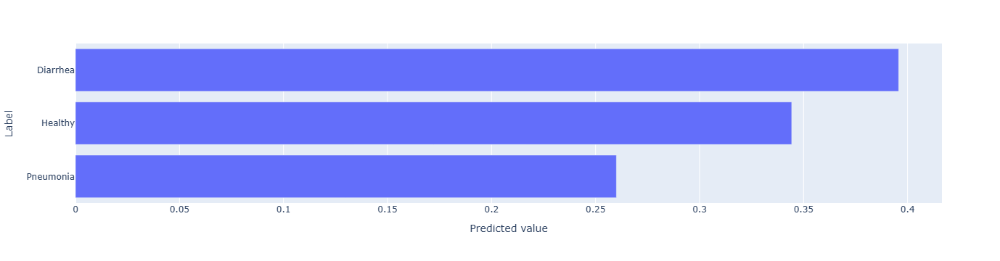

gradcam:


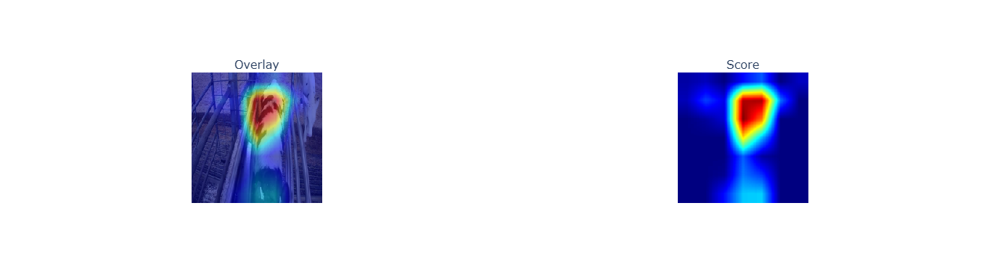

lime:


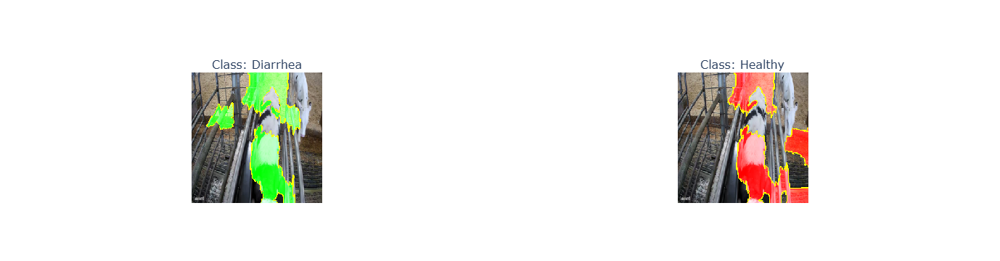

ig:


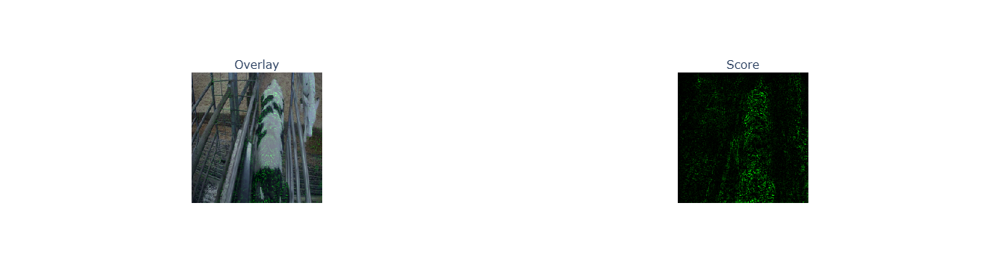

ce:


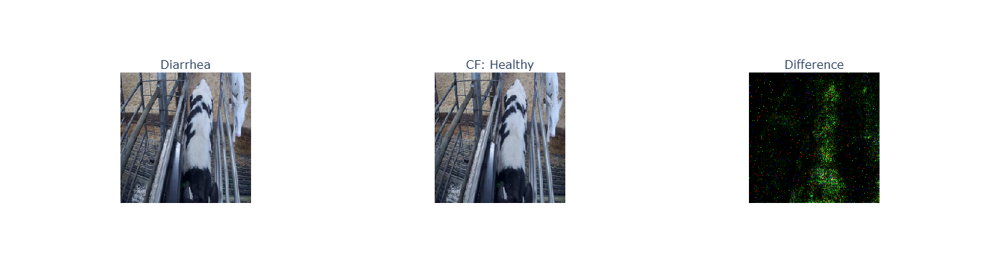

scorecam:


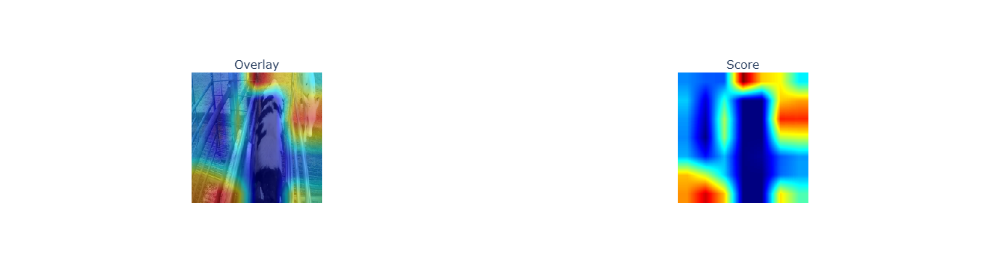

smoothgrad:


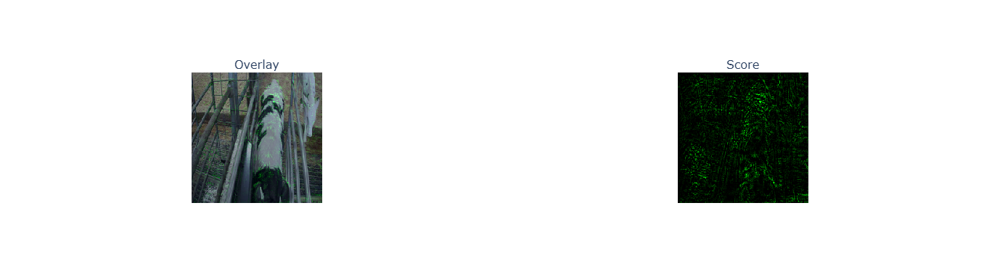

guidedbp:


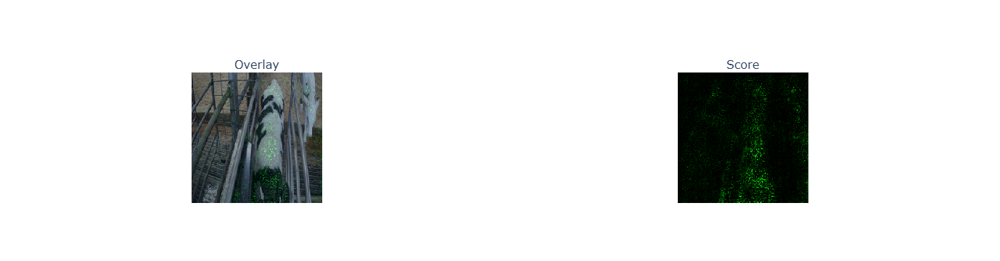

layercam:


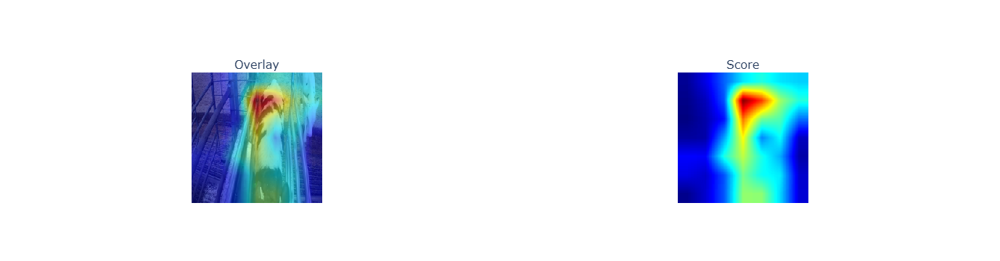

In [23]:
# index=0
# print(valid_loader.dataset.data_frame[:10].to_dict('records')[index])
# plt.imshow(test_images[index][0])

for name, explanations in local_explanations.items():
    print(f"{name}:")
    explanations.ipython_plot(index, class_names=labels)